## Player Types For Clustering ##

```
1) Box to Box Midfielder
2) Holding Midfielder
4) Advanced Playmaker
5) Deep Lying Playmaker
6) Winger
7) False 9
8) Striker 
9) Target Forward
10) Center-Back
11) Wing-Back
12) Full-Back
```

In [697]:
import sqlite3
import pandas as pd
from sklearn.neighbors import NearestNeighbors
import numpy as np
import seaborn as sns
import itertools
import matplotlib.pyplot as plt
from sklearn.naive_bayes import GaussianNB
from sklearn.neighbors import KNeighborsClassifier
from sklearn import model_selection
from sklearn.model_selection import train_test_split
from sklearn.metrics import make_scorer
from time import time
from sklearn.decomposition import PCA, FastICA, NMF
from sklearn.cluster import KMeans
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import silhouette_score, silhouette_samples
import matplotlib.cm as cm

In [698]:
database = 'database.sqlite'
conn = sqlite3.connect(database)
query = "SELECT name FROM sqlite_master WHERE type='table';"
pd.read_sql(query, conn)

,name
0,sqlite_sequence
1,Player_Attributes
2,Player
3,Match
4,League
5,Country
6,Team
7,Team_Attributes


In [699]:
query = "SELECT * FROM Player;"
player_meta_data = pd.read_sql(query, conn)

In [700]:
query = "SELECT * FROM Team;"
team_data = pd.read_sql(query, conn)

In [701]:
query = "SELECT * FROM Player_Attributes;"
player_stats = pd.read_sql(query,conn)

In [702]:
query = "SELECT * FROM League;"
league_data = pd.read_sql(query, conn)

In [703]:
query = "SELECT * FROM Country;"
country_data = pd.read_sql(query, conn)

In [704]:
query = "SELECT * FROM Match;"
match_data = pd.read_sql(query, conn)

In [705]:
query = """SELECT * FROM Player_Attributes a
           INNER JOIN (SELECT player_name, player_api_id AS p_id FROM Player) b ON a.player_api_id = b.p_id;"""
player_stats_wname = pd.read_sql(query,conn)

In [706]:
player_mean_stats = player_stats_wname.groupby(['player_name']).mean()
players_data_2 = player_mean_stats.reset_index()

In [707]:
len(players_data_2)

10848

In [708]:
len(player_mean_stats['p_id'].unique())

10847

In [709]:
def get_current_team_and_country(x):
    global c
    all_rating = c.execute("""SELECT overall_rating FROM Player_Attributes WHERE player_api_id = '%d' """ % (x)).fetchall()
    all_rating = np.array(all_rating,dtype=np.float)[:,0]
    rating = np.nanmean(all_rating)
    if (rating>1): 
        all_football_nums = reversed(range(1,12))
        for num in all_football_nums:
            all_team_id = c.execute("""SELECT home_team_api_id, country_id FROM Match WHERE home_player_%d = '%d'""" % (num,x)).fetchall()
            if len(all_team_id) > 0:
                number_unique_teams = len(np.unique(np.array(all_team_id)[:,0]))
                last_team_id = all_team_id[-1][0]
                last_country_id = all_team_id[-1][1]
                last_country = c.execute("""SELECT name FROM Country WHERE id = '%d'""" % (last_country_id)).fetchall()[0][0]
                last_team = c.execute("""SELECT team_long_name FROM Team WHERE team_api_id = '%d'""" % (last_team_id)).fetchall()[0][0]
                return last_team, last_country, number_unique_teams
    return None, None, 0

In [710]:
conn = sqlite3.connect('database.sqlite')
c = conn.cursor()

In [711]:
# with sqlite3.connect('database.sqlite') as con:
#     sql = "SELECT * FROM Player"
#     max_players_to_analyze = 10848
#     players_data = pd.read_sql_query(sql, con)
#     players_data = players_data.iloc[0:max_players_to_analyze]
#     players_data["team"], players_data["country"], players_data["num_uniq_team"] = np.vectorize(get_current_team_and_country)(players_data["player_api_id"])

In [712]:
# players_data.to_csv('playerteams.csv')

In [713]:
player_teams = pd.read_csv('playerteams.csv')
len(player_teams)

10848

In [714]:
players_final = pd.merge(players_data_2,player_teams, on = 'player_fifa_api_id')

/Users/evanhosmer/anaconda3/lib/python3.6/site-packages/pandas/core/reshape/merge.py:963: UserWarning: You are merging on int and float columns where the float values are not equal to their int representation
  'representation', UserWarning)


In [715]:
cols_drop = ['id_x','player_fifa_api_id','player_api_id_x','Unnamed: 0', 'id_y','player_api_id_y','player_name_y',
            'num_uniq_team']
df_players = players_final.drop(cols_drop,axis = 1)

In [716]:
league_country = pd.merge(league_data,country_data, on = 'id')
league_country.rename(columns={'name_y':'country'}, inplace=True)

In [717]:
final_players = pd.merge(df_players,league_country, on = 'country').drop(['p_id','id','country_id'], axis = 1)
test2 = final_players.drop(['player_name_x','gk_diving','gk_handling','gk_kicking','gk_positioning','gk_reflexes',
                           'birthday','height','weight','team','country','name_x'], axis = 1).dropna()
scaler = StandardScaler()
scaler.fit(test2)
std_data = scaler.transform(test2)
std_data

array([[-0.56590407, -0.79852947, -0.28773765, ...,  0.86723448,
         0.80268189,  0.99109375],
       [ 0.57644712,  0.76784835, -1.18009334, ...,  1.14757623,
         1.10591024,  0.89730168],
       [-0.78409808, -0.34504509, -1.11133762, ...,  0.63442101,
         0.74690481,  0.79336711],
       ...,
       [-1.21639495, -1.92788   , -0.99235019, ...,  0.527992  ,
         0.47663204,  0.48421666],
       [-2.62783742, -2.82176749, -0.20082509, ..., -0.61944581,
        -0.52612506, -0.70092759],
       [-2.3210021 , -1.23021172, -0.75954869, ..., -0.23904523,
        -0.32926477, -0.11747196]])

In [718]:
final_players.drop(['birthday','height','weight'], axis = 1, inplace = True)

In [719]:
no_gks = final_players[final_players['gk_diving'] < 30].dropna()

In [720]:
len(no_gks)

8760

In [721]:
mean_league = no_gks.groupby(['name_x']).mean()

In [722]:
mean_leagues = mean_league.reset_index()

In [723]:
cols = mean_leagues.columns[2:31]
first = mean_leagues['overall_rating']
second = mean_leagues['name_x']
test = mean_leagues[cols]
for column in cols:
    mean = test[column].mean()
    std = test[column].std()
    test[column] = (test[column] - mean) / (std)
    
z_scores = pd.concat([first,test], axis = 1)
z_scores_name = pd.concat([second,z_scores], axis = 1)
z_scores_name.columns

/Users/evanhosmer/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  


Index(['name_x', 'overall_rating', 'potential', 'crossing', 'finishing',
       'heading_accuracy', 'short_passing', 'volleys', 'dribbling', 'curve',
       'free_kick_accuracy', 'long_passing', 'ball_control', 'acceleration',
       'sprint_speed', 'agility', 'reactions', 'balance', 'shot_power',
       'jumping', 'stamina', 'strength', 'long_shots', 'aggression',
       'interceptions', 'positioning', 'vision', 'penalties', 'marking',
       'standing_tackle', 'sliding_tackle'],
      dtype='object')

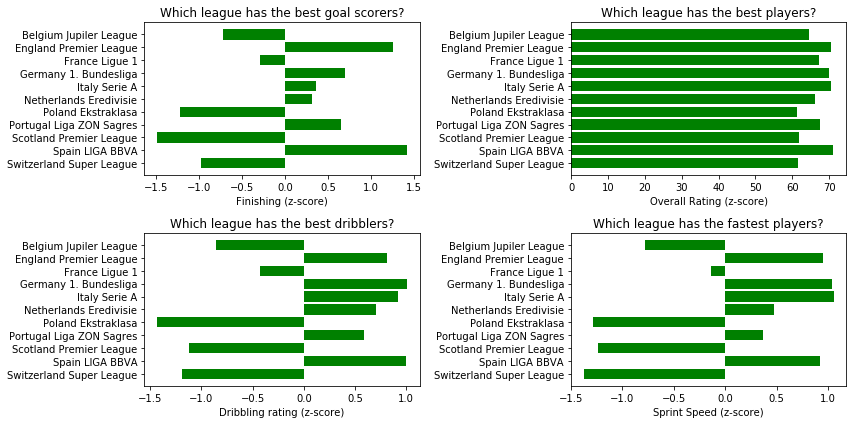

In [724]:
fig = plt.figure(figsize = (12,6))
ax = fig.add_subplot(221)

x = z_scores_name['finishing'].values
y = z_scores_name['name_x'].values

ax.barh(y, x, align='center',
        color='green', ecolor='black')
ax.set_yticks(range(len(y)))
ax.set_yticklabels(y)
ax.invert_yaxis()
ax.set_xlabel('Finishing (z-score)')
ax.set_title('Which league has the best goal scorers?')

ax = fig.add_subplot(222)

x2 = z_scores_name['overall_rating'].values
y2 = z_scores_name['name_x'].values

ax.barh(y2, x2, align='center',
        color='green', ecolor='black')
ax.set_yticks(range(len(y2)))
ax.set_yticklabels(y2)
ax.invert_yaxis()
ax.set_xlabel('Overall Rating (z-score)')
ax.set_title('Which league has the best players?')

ax = fig.add_subplot(223)

x3 = z_scores_name['dribbling'].values
y3 = z_scores_name['name_x'].values

ax.barh(y3, x3, align='center',
        color='green', ecolor='black')
ax.set_yticks(range(len(y3)))
ax.set_yticklabels(y3)
ax.invert_yaxis()
ax.set_xlabel('Dribbling rating (z-score)')
ax.set_title('Which league has the best dribblers?')

ax = fig.add_subplot(224)

x4 = z_scores_name['sprint_speed'].values
y4 = z_scores_name['name_x'].values

ax.barh(y4, x4, align='center',
        color='green', ecolor='black')
ax.set_yticks(range(len(y4)))
ax.set_yticklabels(y4)
ax.invert_yaxis()
ax.set_xlabel('Sprint Speed (z-score)')
ax.set_title('Which league has the fastest players?')

plt.tight_layout()

In [725]:
mean = mean_leagues['overall_rating'].mean()
std = mean_leagues['overall_rating'].std()

mean_leagues['overall_rating'] = (mean_leagues['overall_rating'] - mean) / (std)

In [726]:
cols = final_players.columns
feats = np.array(cols[1:31])
stats = final_players.loc[1548,feats].values
stats2 = final_players.loc[4721,feats].values
len(feats)

30

In [727]:
angles=np.linspace(0, 2*np.pi, len(feats), endpoint=False)
# close the plot
stats=np.concatenate((stats,[stats[0]]))
angles=np.concatenate((angles,[angles[0]]))
stats2 = np.concatenate((stats2,[stats2[0]]))

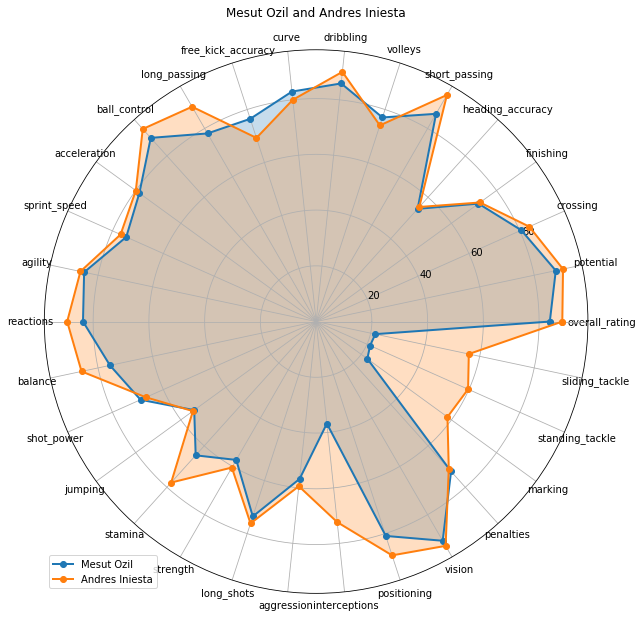

In [728]:
fig=plt.figure(figsize = (18,10))
ax = fig.add_subplot(111, polar=True)
ax.plot(angles, stats, 'o-', linewidth=2, label = 'Mesut Ozil')
ax.fill(angles, stats, alpha=0.25)
ax.plot(angles,stats2,'o-', linewidth=2, label = 'Andres Iniesta')
ax.fill(angles,stats2, alpha= 0.25)
ax.set_thetagrids(angles * 180/np.pi, feats)
ax.set_title('Mesut Ozil and Andres Iniesta')
ax.legend()
ax.grid(True)

In [729]:
def corr_heat(df):
    '''
    INPUT: Dataframe
    OUTPUT: Correlation Heat Map
    '''
    corr = df.corr()
    mask = np.zeros_like(corr, dtype=np.bool)
    mask[np.triu_indices_from(mask)] = True
    f, ax = plt.subplots(figsize=(12, 12))
    cmap = sns.diverging_palette(220, 10, as_cmap=True)
    sns.heatmap(corr, mask=mask, cmap=cmap, vmax=1, center=0,
                square=True, linewidths=.5, cbar_kws={"shrink": .5},xticklabels=corr.index, yticklabels=corr.columns)
    plt.xticks(rotation=60, ha="right")
    plt.yticks(rotation=0)
    ax.set_title("Correlation Heat Map")
    plt.show()

### Table with and without z-score

In [730]:
players = no_gks.drop(['gk_diving','gk_handling','gk_kicking','gk_positioning','gk_reflexes'],axis = 1)
players_no_z = players.copy(deep = True)

In [731]:
len(players_no_z)

8760

In [732]:
cols_feats = players.columns[1:31]
for column in cols_feats:
    mean = players[column].mean()
    std = players[column].std()
    players[column] = (players[column] - mean) / (std)

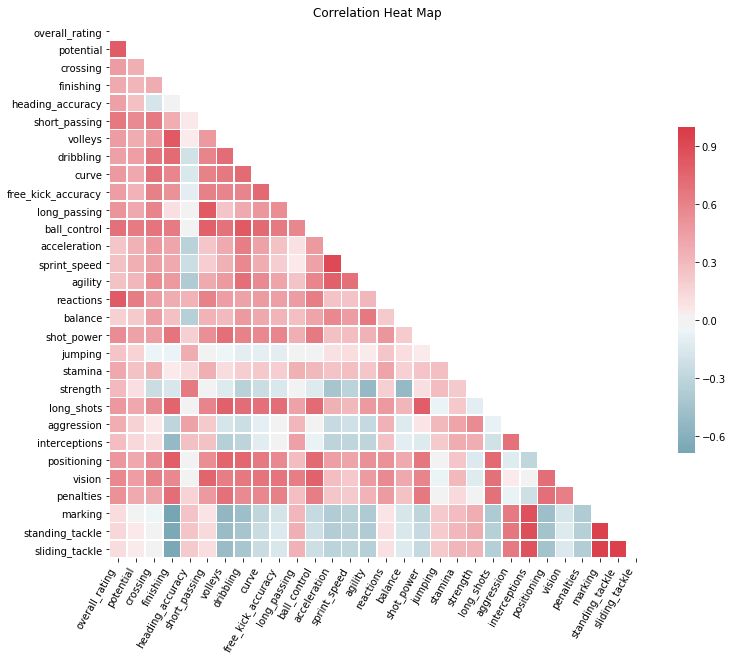

In [733]:
corr_heat(players_no_z)

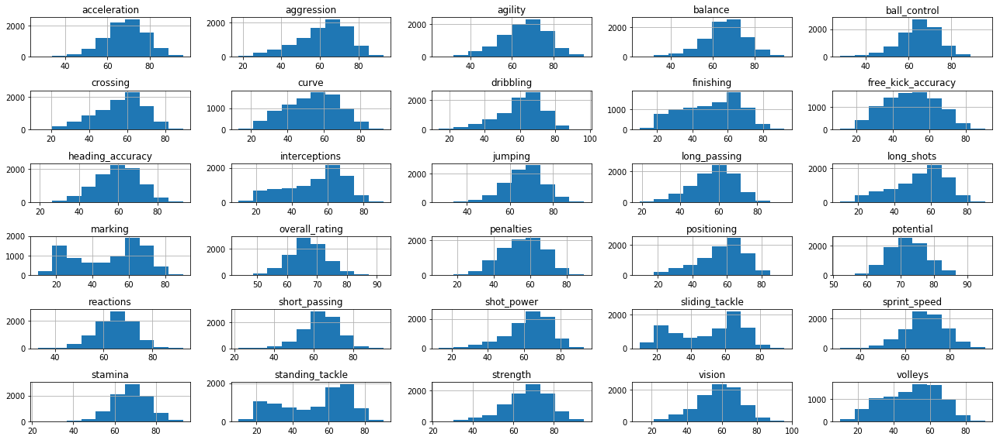

In [734]:
players_no_z.hist(figsize = (18,8))
plt.tight_layout()
plt.show()

In [735]:
overall = players_no_z.sort_values(by=['overall_rating'], ascending = False)
speed = players_no_z.sort_values(by=['sprint_speed'], ascending = False)
dribbling = players_no_z.sort_values(by=['dribbling'], ascending = False)
ball_control = players_no_z.sort_values(by=['ball_control'], ascending = False)
players_no_z['total_passing'] = (players_no_z['long_passing'] + players_no_z['short_passing'] + players_no_z['vision'] + players_no_z['crossing']) / 4
players_no_z['total_defending'] = (players_no_z['standing_tackle'] + players_no_z['sliding_tackle'] + players_no_z['marking'] + players_no_z['interceptions']) / 4
passing = players_no_z.sort_values(by=['total_passing'], ascending = False)
defending = players_no_z.sort_values(by=['total_defending'], ascending = False)


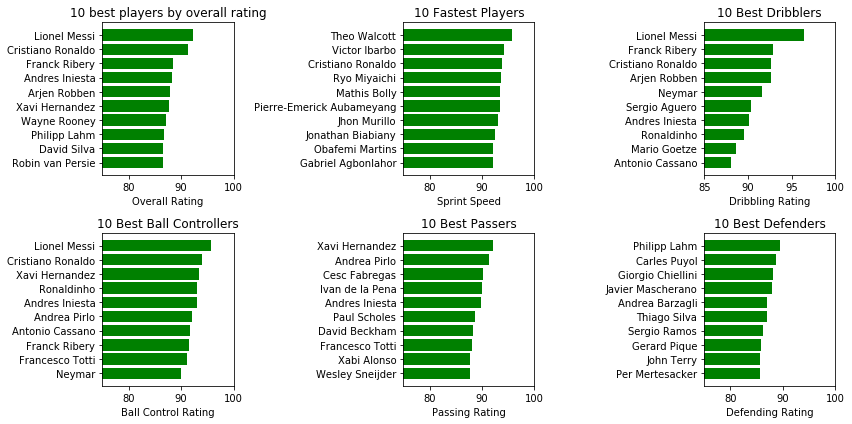

In [736]:
fig = plt.figure(figsize = (12,6))

ax = fig.add_subplot(231)
x = overall.iloc[0:10]['overall_rating'].values
y = overall.iloc[0:10]['player_name_x'].values

ax.barh(y, x, align='center',
        color='green', ecolor='black')
ax.set_yticks(range(len(y)))
ax.set_yticklabels(y)
ax.set_xlim(75,100)
ax.invert_yaxis()
ax.set_xlabel('Overall Rating')
ax.set_title('10 best players by overall rating')

ax2 = fig.add_subplot(232)
x2 = speed.iloc[0:10]['sprint_speed'].values
y2 = speed.iloc[0:10]['player_name_x'].values

ax2.barh(y2, x2, align='center',
        color='green', ecolor='black')
ax2.set_yticks(range(len(y2)))
ax2.set_yticklabels(y2)
ax2.set_xlim(75,100)
ax2.invert_yaxis()
ax2.set_xlabel('Sprint Speed')
ax2.set_title('10 Fastest Players')

ax3 = fig.add_subplot(233)
x3 = dribbling.iloc[0:10]['dribbling'].values
y3 = dribbling.iloc[0:10]['player_name_x'].values

ax3.barh(y3, x3, align='center',
        color='green', ecolor='black')
ax3.set_yticks(range(len(y3)))
ax3.set_yticklabels(y3)
ax3.set_xlim(85,100)
ax3.invert_yaxis()
ax3.set_xlabel('Dribbling Rating')
ax3.set_title('10 Best Dribblers')

ax4 = fig.add_subplot(234)
x4 = ball_control.iloc[0:10]['ball_control'].values
y4 = ball_control.iloc[0:10]['player_name_x'].values

ax4.barh(y4, x4, align='center',
        color='green', ecolor='black')
ax4.set_yticks(range(len(y4)))
ax4.set_yticklabels(y4)
ax4.set_xlim(75,100)
ax4.invert_yaxis()
ax4.set_xlabel('Ball Control Rating')
ax4.set_title('10 Best Ball Controllers')

ax5 = fig.add_subplot(235)
x5 = passing.iloc[0:10]['total_passing'].values
y5 = passing.iloc[0:10]['player_name_x'].values

ax5.barh(y5, x5, align='center',
        color='green', ecolor='black')
ax5.set_yticks(range(len(y5)))
ax5.set_yticklabels(y5)
ax5.set_xlim(75,100)
ax5.invert_yaxis()
ax5.set_xlabel('Passing Rating')
ax5.set_title('10 Best Passers')

ax6 = fig.add_subplot(236)
x6 = defending.iloc[0:10]['total_defending'].values
y6 = defending.iloc[0:10]['player_name_x'].values

ax6.barh(y6, x6, align='center',
        color='green', ecolor='black')
ax6.set_yticks(range(len(y6)))
ax6.set_yticklabels(y6)
ax6.set_xlim(75,100)
ax6.invert_yaxis()
ax6.set_xlabel('Defending Rating')
ax6.set_title('10 Best Defenders')

plt.tight_layout()

In [737]:
import statsmodels.api as sm
from statsmodels.stats.outliers_influence import variance_inflation_factor

In [738]:
X = players_no_z.drop(['player_name_x','team','country','name_x','total_passing','total_defending'], axis = 1)
X = X.dropna()
X2 = players.dropna()
X2 = X2.drop(['player_name_x','team','country','name_x'], axis = 1)

In [739]:
vif = pd.DataFrame()
vif["VIF Factor"] = [variance_inflation_factor(X2.values, i) for i in range(X2.shape[1])]
vif["features"] = X.columns

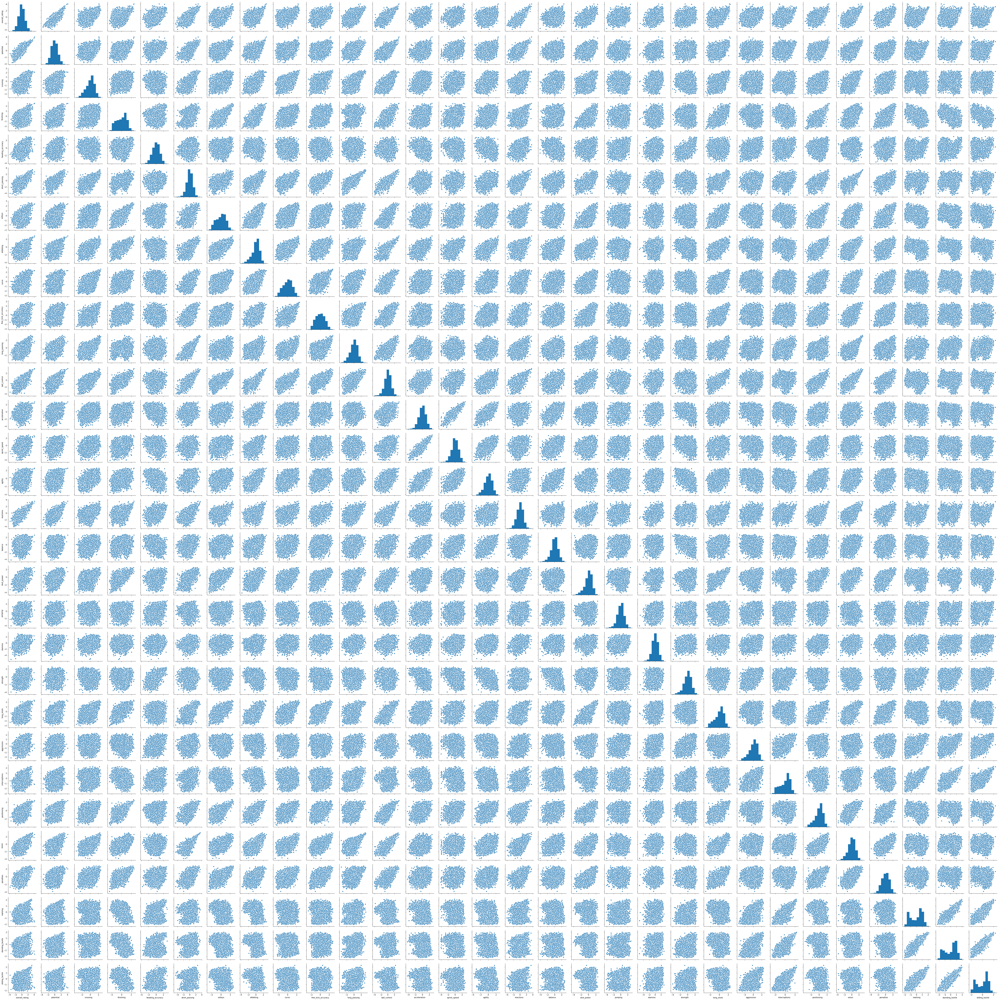

In [740]:
sns.pairplot(X2)

## Gonna need some PCA before clustering

In [741]:
def scree_plot(pca):
    vals = pca.explained_variance_ratio_
    plt.figure(figsize=(10, 6), dpi=250)
    cum_var = np.cumsum(vals)
    ax = plt.subplot(111)

    ax.plot(range(len(vals) + 1), np.insert(cum_var, 0, 0), color = 'r', marker = 'o')
    ax.bar(range(len(vals)), vals, alpha = 0.8)
    
    ax.axhline(0.9, color = 'g', linestyle = "--")
    ax.set_xlabel("Principal Component", fontsize=12)
    ax.set_ylabel("Variance Explained (%)", fontsize=12)

    plt.title("Scree Plot for Soccer Data", fontsize=16)

In [742]:
def scree_plot(pca):
    vals = pca.explained_variance_ratio_
    plt.figure(figsize=(10, 6), dpi=250)
    cum_var = np.cumsum(vals)
    ax = plt.subplot(111)

    ax.plot(range(len(vals) + 1), np.insert(cum_var, 0, 0), color = 'r', marker = 'o')
    ax.bar(range(len(vals)), vals, alpha = 0.8)
    
    ax.axhline(0.9, color = 'g', linestyle = "--")
    ax.set_xlabel("Principal Component", fontsize=12)
    ax.set_ylabel("Variance Explained (%)", fontsize=12)

    plt.title("Scree Plot for Soccer Data", fontsize=16)

In [743]:
test = pca1.components_
test.shape
test[0]

array([ 0.17963799,  0.16361312,  0.20713218,  0.23454752, -0.02188572,
        0.20487555,  0.24063665,  0.2582318 ,  0.23771784,  0.2138365 ,
        0.14055081,  0.25968313,  0.17515502,  0.16099526,  0.20545769,
        0.17604651,  0.15036606,  0.21683419, -0.00613841,  0.08233543,
       -0.07131928,  0.24632559, -0.03901922, -0.07199049,  0.24862355,
        0.23263444,  0.21479023, -0.1316936 , -0.11928019, -0.11925775])

### K-Means

### Try 12 for each of the previously identified playstyles

In [744]:
kmeans = KMeans(n_clusters = 12).fit(X_pca)

In [745]:
labels = players['player_name_x']
labels = np.array(labels).reshape(8760,1)
pca_w_labels = np.concatenate((labels,X_pca), axis = 1)


In [746]:
centers = kmeans.cluster_centers_
k_labels = kmeans.labels_
test2 = k_labels.reshape(8760,1)
players_clusters = np.concatenate((labels,test2), axis = 1)
df = pd.DataFrame({'Player': players_clusters[:,0],'Cluster':players_clusters[:,1]})

In [747]:
test2 = k_labels.reshape(8760,1)
players_clusters = np.concatenate((labels,test2), axis = 1)
players_clusters

array([['Aaron Appindangoye', 11],
       ['Abdoulaye Ba', 2],
       ['Abdullah Al Hafith', 9],
       ...,
       ['Wojciech Szymanek', 9],
       ['Wojciech Trochim', 8],
       ['Wojciech Zyska', 11]], dtype=object)

In [748]:
df = pd.DataFrame({'Player': players_clusters[:,0],'Cluster':players_clusters[:,1]})

```
1) Box to Box Midfielder (Paul Pogba) -> 10
2) Holding Midfielder (Sergio Busquets) -> 10
4) Advanced Playmaker (Mesut Ozil) -> 6
5) Deep Lying Playmaker (Pirlo) -> 6
6) Winger (Neymar) -> 6
7) False 9 (Messi) -> 6
8) Striker (Wayne Rooney) -> 6
9) Target Forward (Olivier Giroud) -> 3
10) Center-Back (Diego Godin) -> 7
11) Wing-Back (Kyle Walker) -> 10
12) Full-Back (Philipp Lahm) -> 10
```

Not great

In [749]:
silhouette_avg = silhouette_score(X_pca, k_labels)
print(silhouette_avg)

0.14012966759107254


oof

In [751]:
def prep_player_data (df):
    work_rate_dict = {'low': 0, 'medium': 1, 'high': 2}
    pref_foot_dict = {'left': 0, 'right': 1, 'None': 2}

    df = df.loc[(df['attacking_work_rate'].isin(work_rate_dict.keys())) & 
                (df['defensive_work_rate'].isin(work_rate_dict.keys()))].copy()
    
    df.loc[:, 'preferred_foot'] = df.loc[:, 'preferred_foot'].map(pref_foot_dict)
    df.loc[:, 'attacking_work_rate'] = df.loc[:, 'attacking_work_rate'].map(work_rate_dict)
    df.loc[:, 'defensive_work_rate'] = df.loc[:, 'defensive_work_rate'].map(work_rate_dict)
    
    columns = ['potential', 'preferred_foot', 'attacking_work_rate', 'defensive_work_rate',
              'crossing', 'finishing', 'heading_accuracy', 'short_passing', 'volleys', 
              'dribbling', 'curve', 'free_kick_accuracy', 'long_passing', 'ball_control',
              'acceleration', 'sprint_speed', 'agility', 'reactions', 'balance', 'shot_power',
              'jumping', 'stamina', 'strenght', 'long_shots', 'aggression', 'interceptions',
              'positioning', 'vision', 'penalties', 'marking', 'standing_tackle', 'sliding_tackle',
              'gk_diving', 'gk_handling', 'gk_kicking', 'gk_positioning', 'gk_reflexes', 'player_api_id']
    df = df.loc[:, player_stats.columns.isin(columns)]
    
    return df

In [752]:
df = prep_player_data(player_stats)
df_mean = df.groupby(['player_api_id']).mean()

In [753]:
df_mean = df.groupby(['player_api_id']).mean()

In [754]:
df_std = df_mean.drop(['preferred_foot','attacking_work_rate','defensive_work_rate'], axis = 1)
df_dummies = df_mean[['preferred_foot','attacking_work_rate','defensive_work_rate']].values
scaler = StandardScaler()
scaler.fit(df_std)
new_x = scaler.transform(df_std)
new_x.shape
final_data = np.concatenate((new_x,df_dummies), axis = 1)
final_data.shape

(9925, 36)

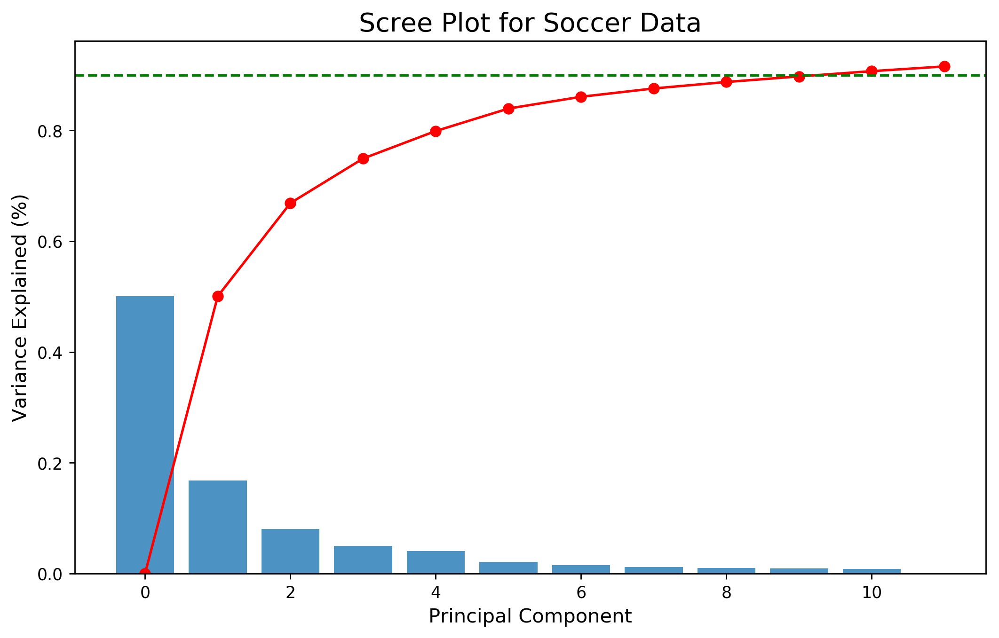

In [770]:
cols = df_mean.columns
X4 = final_data
pca4 = PCA(n_components=11)
X_pca4 = pca4.fit_transform(X4)
scree_plot(pca4)
comps = pca4.components_
df_pca = pd.DataFrame(comps, columns= cols)
df_pca = df_pca.abs()
nlargest = 5
order = np.argsort(-df_pca.values, axis=1)[:, :nlargest]
result = pd.DataFrame(df_pca.columns[order], 
                      columns=['top{}'.format(i) for i in range(1, nlargest+1)])



In [767]:
result

,top1,top2,top3,top4,top5
0,curve,crossing,heading_accuracy,preferred_foot,long_shots
1,positioning,vision,penalties,stamina,jumping
2,acceleration,potential,sliding_tackle,gk_diving,standing_tackle
3,free_kick_accuracy,long_passing,ball_control,sprint_speed,defensive_work_rate
4,reactions,defensive_work_rate,dribbling,preferred_foot,volleys
5,potential,reactions,sprint_speed,long_passing,volleys
6,balance,reactions,sprint_speed,potential,jumping
7,sprint_speed,volleys,short_passing,reactions,aggression
8,dribbling,balance,sprint_speed,interceptions,crossing
9,acceleration,agility,potential,short_passing,shot_power


For n_clusters = 2 The average silhouette_score is : 0.5797934131413248


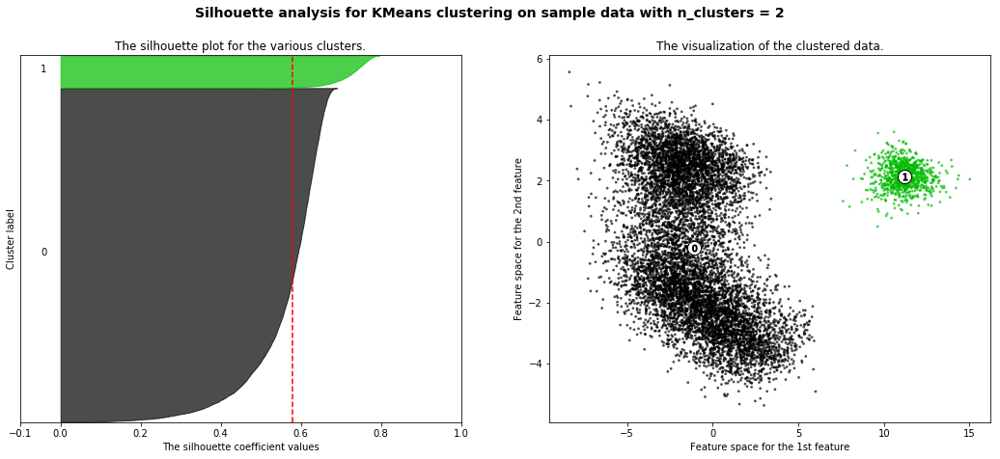

For n_clusters = 3 The average silhouette_score is : 0.3022276952485352


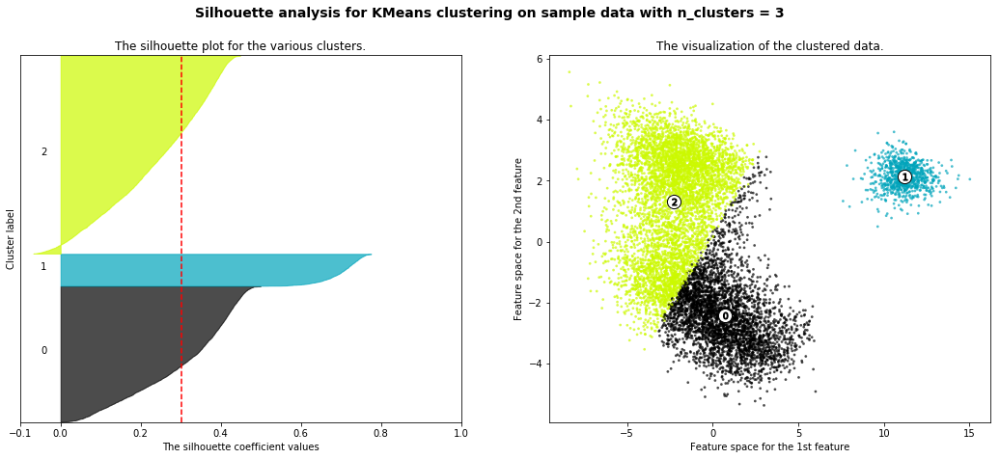

For n_clusters = 4 The average silhouette_score is : 0.2831348564435645


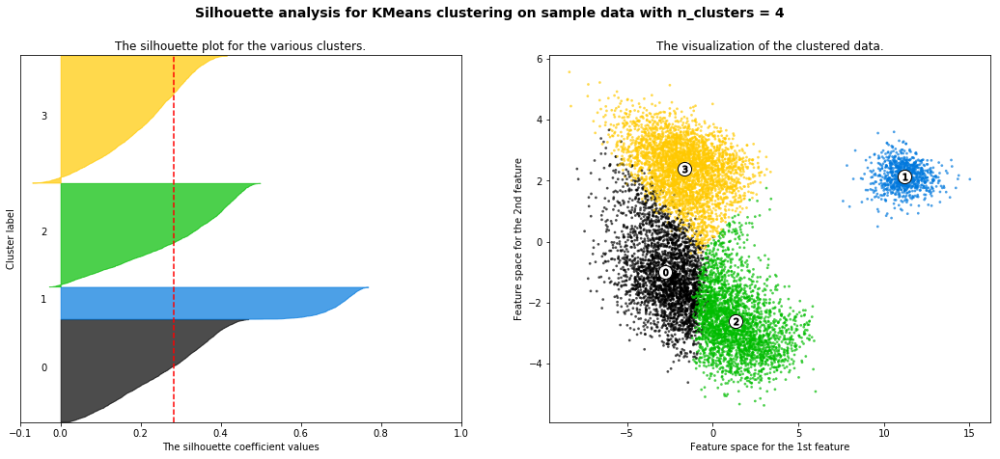

For n_clusters = 5 The average silhouette_score is : 0.26293734772870003


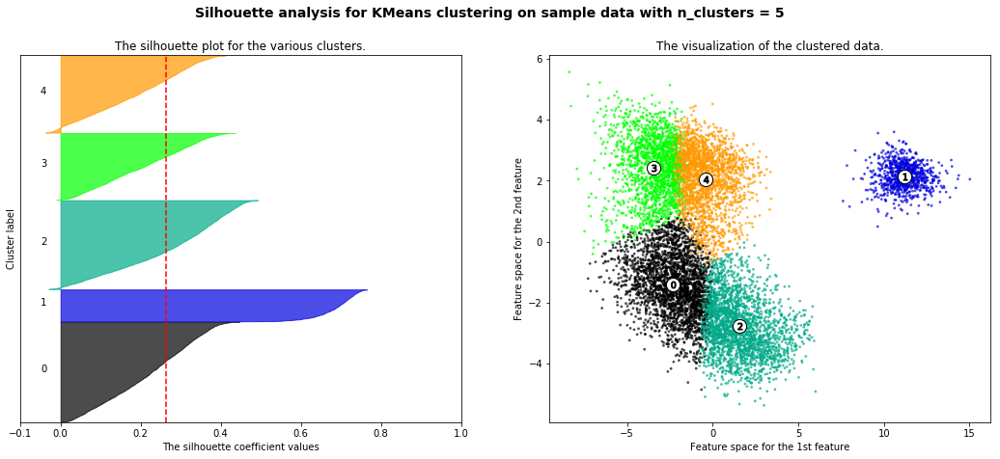

For n_clusters = 6 The average silhouette_score is : 0.22553046204307906


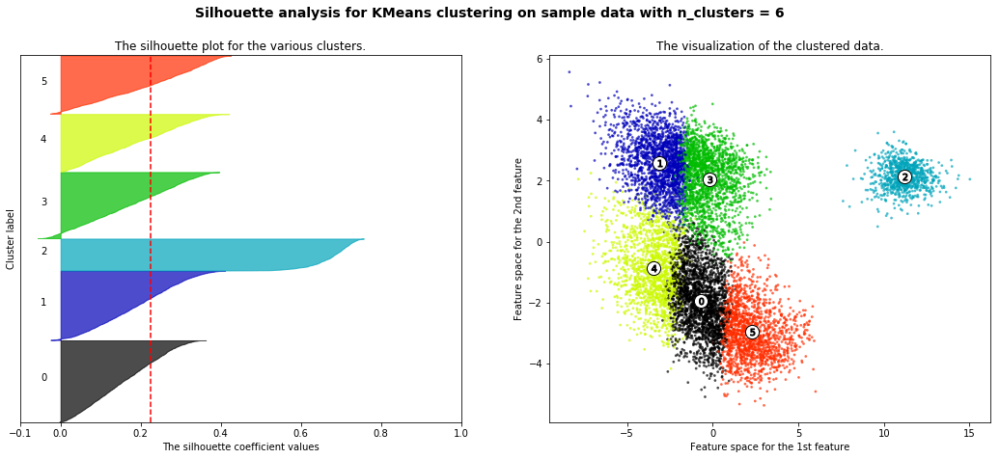

For n_clusters = 7 The average silhouette_score is : 0.2178928599352158


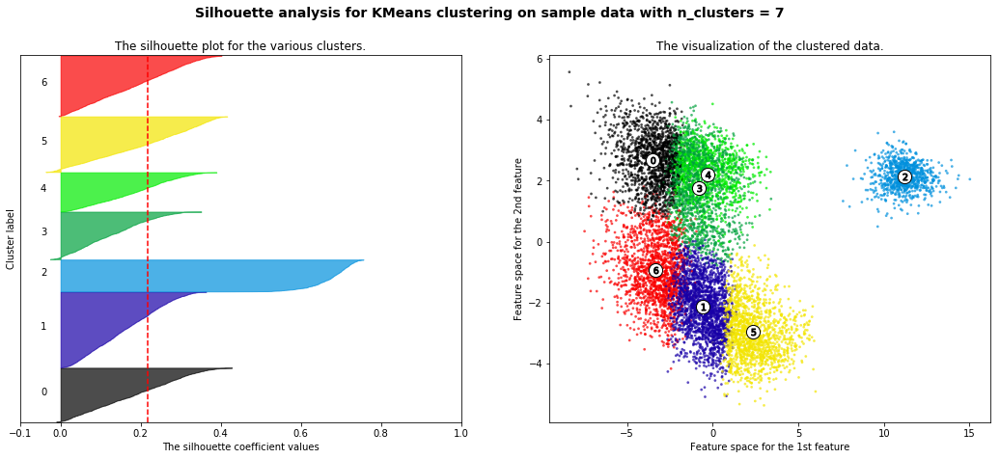

For n_clusters = 8 The average silhouette_score is : 0.2095447773214573


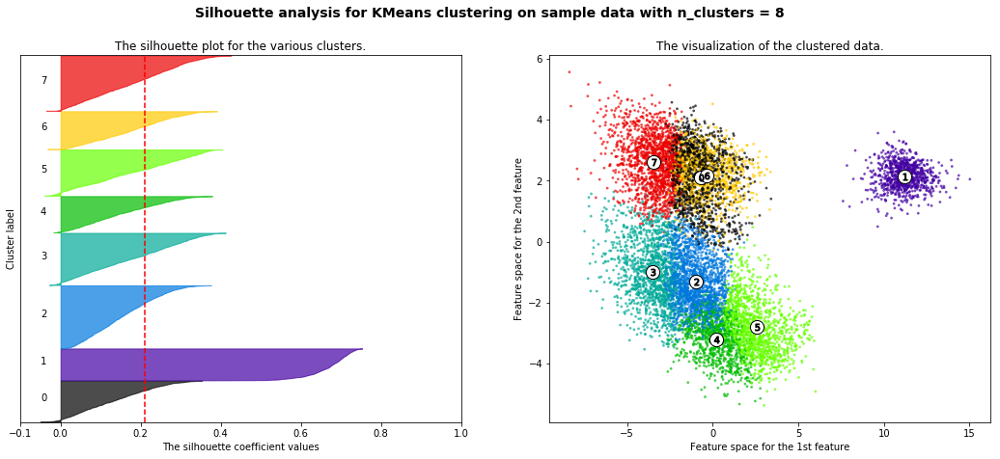

For n_clusters = 9 The average silhouette_score is : 0.20691391327669792


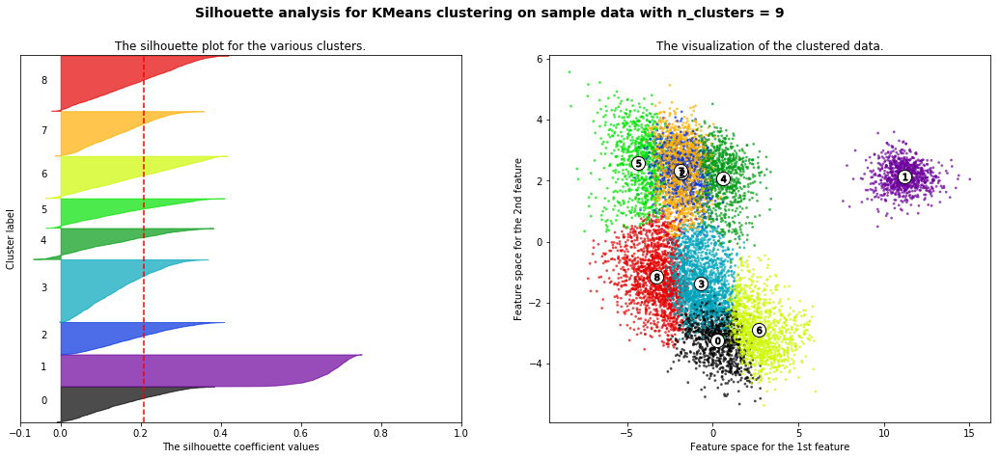

For n_clusters = 10 The average silhouette_score is : 0.1996265400233552


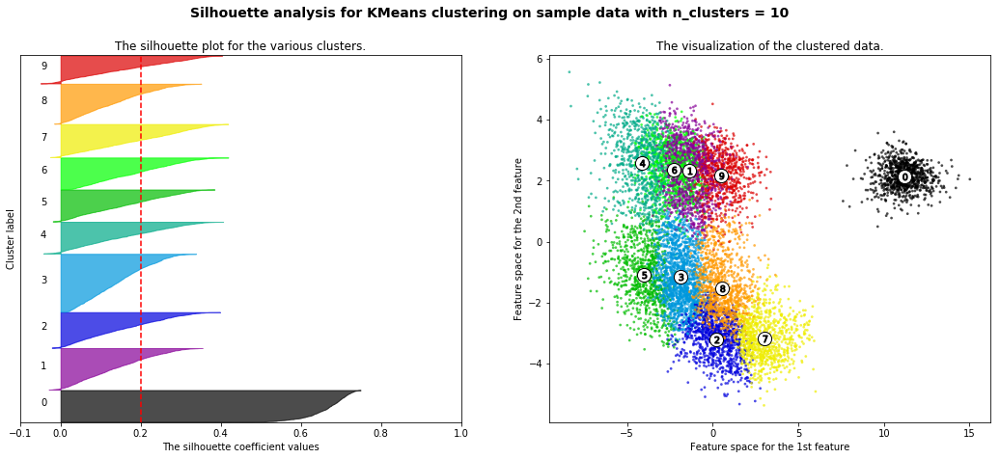

For n_clusters = 11 The average silhouette_score is : 0.19919445452959744


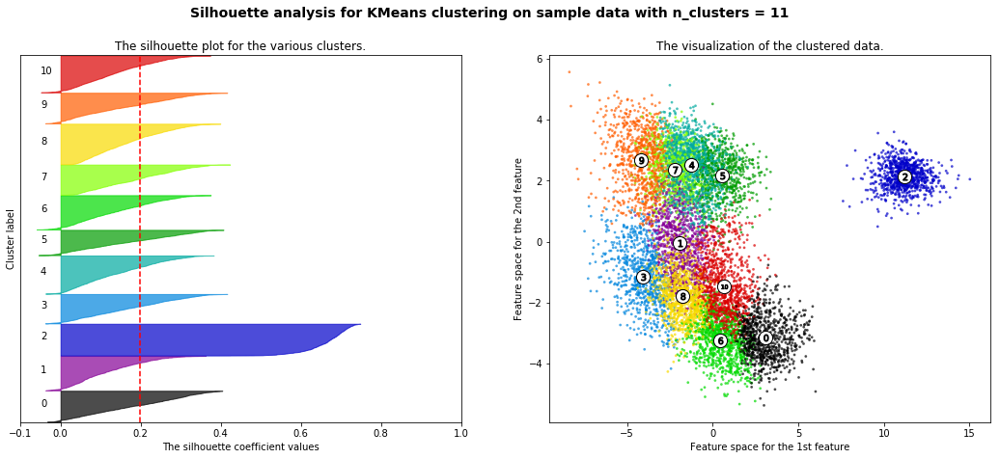

For n_clusters = 12 The average silhouette_score is : 0.16286403759512125


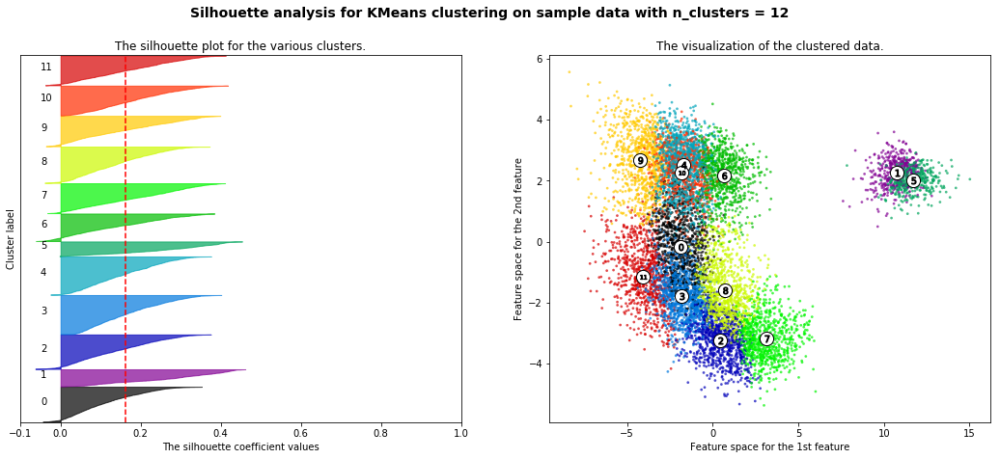

In [756]:
X = X_pca4


range_n_clusters = [2, 3, 4, 5, 6,7,8,9,10,11,12]

for n_clusters in range_n_clusters:
    # Create a subplot with 1 row and 2 columns
    fig, (ax1, ax2) = plt.subplots(1, 2)
    fig.set_size_inches(18, 7)

    # The 1st subplot is the silhouette plot
    # The silhouette coefficient can range from -1, 1 but in this example all
    # lie within [-0.1, 1]
    ax1.set_xlim([-0.1, 1])
    # The (n_clusters+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    ax1.set_ylim([0, len(X) + (n_clusters + 1) * 10])

    # Initialize the clusterer with n_clusters value and a random generator
    # seed of 10 for reproducibility.
    clusterer = KMeans(n_clusters=n_clusters, random_state=10)
    cluster_labels = clusterer.fit_predict(X)

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed
    # clusters
    silhouette_avg = silhouette_score(X, cluster_labels)
    print("For n_clusters =", n_clusters,
          "The average silhouette_score is :", silhouette_avg)

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(X, cluster_labels)

    y_lower = 10
    for i in range(n_clusters):
        # Aggregate the silhouette scores for samples belonging to
        # cluster i, and sort them
        ith_cluster_silhouette_values = \
            sample_silhouette_values[cluster_labels == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = cm.nipy_spectral(float(i) / n_clusters)
        ax1.fill_betweenx(np.arange(y_lower, y_upper),
                          0, ith_cluster_silhouette_values,
                          facecolor=color, edgecolor=color, alpha=0.7)

        # Label the silhouette plots with their cluster numbers at the middle
        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    ax1.set_title("The silhouette plot for the various clusters.")
    ax1.set_xlabel("The silhouette coefficient values")
    ax1.set_ylabel("Cluster label")

    # The vertical line for average silhouette score of all the values
    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

    ax1.set_yticks([])  # Clear the yaxis labels / ticks
    ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

    # 2nd Plot showing the actual clusters formed
    colors = cm.nipy_spectral(cluster_labels.astype(float) / n_clusters)
    ax2.scatter(X[:, 0], X[:, 1], marker='.', s=30, lw=0, alpha=0.7,
                c=colors, edgecolor='k')

    # Labeling the clusters
    centers = clusterer.cluster_centers_
    # Draw white circles at cluster centers
    ax2.scatter(centers[:, 0], centers[:, 1], marker='o',
                c="white", alpha=1, s=200, edgecolor='k')

    for i, c in enumerate(centers):
        ax2.scatter(c[0], c[1], marker='$%d$' % i, alpha=1,
                    s=50, edgecolor='k')

    ax2.set_title("The visualization of the clustered data.")
    ax2.set_xlabel("Feature space for the 1st feature")
    ax2.set_ylabel("Feature space for the 2nd feature")

    plt.suptitle(("Silhouette analysis for KMeans clustering on sample data "
                  "with n_clusters = %d" % n_clusters),
                 fontsize=14, fontweight='bold')

    plt.show()

In [ ]:
model_f = KMeans(n_clusters = 6).fit(X_pca4)
centers = model_f.cluster_centers_
k_labels = model_f.labels_

In [ ]:
df2 = prep_player_data(player_stats)
df_mean2 = df2.groupby(['player_api_id']).mean().reset_index()
test3 = df_mean2.merge(player_meta_data, on = 'player_api_id')
names = test3['player_name']
points = {i: X_pca4[np.where(model_f.labels_ == i)] for i in range(model_f.n_clusters)}
name_index = {i: np.where(model_f.labels_ == i)[0] for i in range(model_f.n_clusters)}


In [ ]:
nbrs = NearestNeighbors(n_neighbors=6, algorithm='ball_tree').fit(points[1])
distances, indices = nbrs.kneighbors(points[1])
len(points[1])

In [ ]:
names_clusters = pd.DataFrame({'Player': names,'Cluster': k_labels})

```
Interpretation From Clustering
1) Center Backs
2) Forwards/Advanced Playmakers
3) Goalkeepers
4) Full Backs/Center Backs
5) Box to Box Midfielders/Holding Midfielders
6) Wingers/Wingbacks

```

In [ ]:
points = {i: np.where(model_f.labels_ == i)[0] for i in range(model_f.n_clusters)}
idx = points[0]
names_np = np.array(names).reshape(9925,1)
test = np.concatenate((names_np,X_pca4), axis = 1)

In [ ]:
points = {i: np.where(model_f.labels_ == i)[0] for i in range(model_f.n_clusters)}
clusters = []
for idx in range(6):
    cluster = test[points[idx]]
    clusters.append(cluster)
    
clusters

## KNN

In [ ]:
def K_nearest(player, nameslist, cluster_list, X):
    
    nbrs = NearestNeighbors(n_neighbors=6, algorithm='ball_tree').fit(X_pca4)
    distances, indices = nbrs.kneighbors(X_pca4)
    idx = np.where(nameslist == player)[0][0]
    dist = distances[idx][1:]
    ind = indices[idx][1:]
    five_names = np.array(nameslist[ind])
    
    return dist, five_names, ind, indices

dist, five_names, ind, indices = K_nearest('Mesut Oezil', names, names_clusters, X_pca4)

In [ ]:
def five_nearest_radar(player, nameslist, fivenearest, indices, cols, X):

    idx = np.where(nameslist == player)[0][0]
    ind = indices[idx]
    cols = cols
    feats = np.array(cols)
    stats = X.loc[ind[0],feats].values
    stats1 = X.loc[ind[1],feats].values
    stats2 = X.loc[ind[2],feats].values
    stats3 = X.loc[ind[3],feats].values
    stats4 = X.loc[ind[4],feats].values
    stats5 = X.loc[ind[5],feats].values


    angles=np.linspace(0, 2*np.pi, len(feats), endpoint=False)
    stats=np.concatenate((stats,[stats[0]]))
    angles=np.concatenate((angles,[angles[0]]))
    stats1 = np.concatenate((stats1,[stats1[0]]))
    stats2 = np.concatenate((stats2,[stats2[0]]))
    stats3 = np.concatenate((stats3,[stats3[0]]))
    stats4 = np.concatenate((stats4,[stats4[0]]))
    stats5 = np.concatenate((stats5,[stats5[0]]))


    fig=plt.figure(figsize = (18,10))
    ax = fig.add_subplot(111, polar=True)
    ax.plot(angles, stats, 'o-', linewidth=2, label = player)
    ax.fill(angles, stats, alpha=0.25)
    ax.plot(angles,stats1,'o-', linewidth=2, label = fivenearest[0])
    ax.fill(angles,stats1, alpha= 0.25)
    ax.plot(angles,stats2,'o-', linewidth=2, label = fivenearest[1])
    ax.fill(angles,stats2, alpha= 0.25)
    ax.plot(angles,stats3,'o-', linewidth=2, label = fivenearest[2])
    ax.fill(angles,stats3, alpha= 0.25)
    ax.plot(angles,stats4,'o-', linewidth=2, label = fivenearest[3])
    ax.fill(angles,stats4, alpha= 0.25)
    ax.plot(angles,stats5,'o-', linewidth=2, label = fivenearest[4])
    ax.fill(angles,stats5, alpha= 0.25)
    ax.set_thetagrids(angles * 180/np.pi, feats)
    ax.set_title('Top Five Most Similar to' + ' ' + player)
    ax.legend()
    ax.grid(True)
    
dist, five_names, ind, indices = K_nearest('Manuel Neuer', names, names_clusters, X_pca4)
df = prep_player_data(player_stats)
df_mean = df.groupby(['player_api_id']).mean().reset_index()
df_mean = df_mean.drop(['player_api_id'], axis = 1)
five_nearest_radar('Manuel Neuer', names, five_names, indices, df_mean.columns, df_mean)

### NMF

In [ ]:
from sklearn.preprocessing import normalize, MinMaxScaler

In [ ]:
df_mean_no_gk = df_mean[df_mean['gk_diving'] < 30]
df_mean_no_gk.drop(['gk_diving','gk_handling','gk_kicking','gk_positioning','gk_reflexes'], axis = 1, inplace = True)

In [ ]:
df_std_norm = df_mean_no_gk.drop(['preferred_foot','attacking_work_rate','defensive_work_rate'], axis = 1)
df_dummies_norm = df_mean_no_gk[['preferred_foot','attacking_work_rate','defensive_work_rate']].values
scaler = MinMaxScaler()
new_x_norm = scaler.fit_transform(df_std_norm)
final_data_norm = np.concatenate((new_x_norm,df_dummies_norm), axis = 1)

In [757]:
# Find latent topics using our NMF model.
model = NMF(n_components=6, max_iter=250)
model.fit(final_data_norm)
W = model.fit_transform(final_data_norm)
H = model.components_

In [758]:
H.shape

(6, 31)

In [759]:
W.shape

(9055, 6)

In [760]:
H.shape

(6, 31)

In [761]:
type(H)

numpy.ndarray

In [762]:
array = np.argsort(H)
array

array([[30, 28, 27, 25, 26, 29, 21, 17, 12, 11, 15, 18, 20, 13,  3,  0,
         9, 14,  1,  4,  6, 10, 23, 22,  7,  8, 16, 24,  2,  5, 19],
       [28,  2, 29, 13, 12, 11,  5, 15,  6, 22, 30, 19,  7, 24, 10,  8,
         1,  0, 23, 16, 17, 18, 14,  4,  3,  9, 20, 21, 27, 25, 26],
       [30, 29,  7,  8, 27,  1, 25,  9, 26, 21, 19, 23,  4, 10, 14,  5,
         6,  0, 20, 16, 18, 22, 24,  2, 13, 15, 12, 11,  3, 17, 28],
       [15, 28, 23,  9,  8, 30,  4,  7,  0, 10, 21, 24, 19, 14,  5,  1,
        25, 13, 27, 26,  3,  6, 17, 16,  2, 11, 22, 20, 12, 18, 29],
       [ 1, 28, 29,  7,  8,  9, 10, 14, 21,  0, 27, 25, 26,  4,  6, 23,
        24,  5, 19, 22,  2,  3, 13, 11, 12, 16, 15, 20, 17, 18, 30],
       [30, 28,  3, 29, 24, 19,  2,  5,  8, 16, 20, 21, 23, 14,  9, 26,
        25, 22, 27,  4,  7,  0, 10, 18, 17,  6,  1, 15, 13, 12, 11]])

In [763]:
top_fives = []
for idx in range(len(array)):
    top_five = array[idx][-5:]
    top_five_r = top_five[::-1]
    top_fives.append(top_five_r)

In [764]:
top_fives

[array([19,  5,  2, 24, 16]),
 array([26, 25, 27, 21, 20]),
 array([28, 17,  3, 11, 12]),
 array([29, 18, 12, 20, 22]),
 array([30, 18, 17, 20, 15]),
 array([11, 12, 13, 15,  1])]

In [765]:
cols = df_mean.columns
five_names = []
for idx in range(len(top_fives)):
    arr = top_fives[idx]
    names = []
    five_names.append(names)
    for val in arr:
        name = cols[val]
        names.append(name)
        

In [766]:
five_names

[['shot_power',
  'finishing',
  'attacking_work_rate',
  'interceptions',
  'agility'],
 ['vision', 'positioning', 'penalties', 'stamina', 'jumping'],
 ['marking',
  'reactions',
  'defensive_work_rate',
  'free_kick_accuracy',
  'long_passing'],
 ['standing_tackle', 'balance', 'long_passing', 'jumping', 'long_shots'],
 ['sliding_tackle', 'balance', 'reactions', 'jumping', 'sprint_speed'],
 ['free_kick_accuracy',
  'long_passing',
  'ball_control',
  'sprint_speed',
  'preferred_foot']]

```
1) Striker
2) False 9/ Target Forward
3) Wing Backs
4) Center Backs/ Holding Midfielder
5) Full Backs
6) Deep Lying Playmaker
7) Box to Box Midfielder
8) Winger

```

In [ ]:
names_2 = pd.DataFrame(names_np)
df_mean_w_names = pd.concat([names_2,df_mean], axis = 1)

In [ ]:
names_nogk = df_mean_w_names[df_mean_w_names['gk_diving'] < 30]
testdf = names_nogk.drop(['gk_diving','gk_handling','gk_kicking','gk_positioning','gk_reflexes'], axis = 1)

In [ ]:
testdf = testdf.rename(index=str, columns={0: "name"})

In [ ]:
testdf[testdf['name'] == 'Diego Godin']

In [ ]:
W[1669]